In [166]:
import numpy as np
import imgaug.augmenters as iaa
import os
import shutil
import cv2

train_path = './train_aug'
mask_path = './mask_aug'


train_list = sorted(os.listdir(train_path))
mask_list = sorted(os.listdir(mask_path))
mask_list = mask_list[1:]
#unknown = [image for image in image_names if image not in mask_names]
#print(unknown)
#unknown2 = [image for image in mask_names if image not in image_names]
#print(unknown2)
#print(len(train_list))
#print(len(mask_list))
#mask_names = [mask for mask in train_list if mask.split('.')[1] == 'png']
#for mask in mask_names:
#    shutil.move(os.path.join(train_path, mask),os.path.join(mask_path, mask))
#train_names = sorted([image.split('.')[0] for image in train_list])
#train_list = train_list[1:]
#print(train_list)
#print(mask_list)
#mask_names = sorted([image.split('_color_mask')[0] for image in mask_list])
#print(train_names)
#print(mask_names)

#t = cv2.imread(os.path.join(train_path,'_45.jpg'))
#m = cv2.imread(os.path.join(mask_path,'_45_color_mask.png'))
#print(t.shape)
#t = cv2.resize(t, dsize=(1200, 800))
#m = cv2.resize(m, dsize=(1200, 800))
#cv2.imwrite(os.path.join(train_path,'_45.jpg'), t)
#cv2.imwrite(os.path.join(mask_path,'_45_color_mask.png'), m)


#for i in range(len(image_names)):
#    t = cv2.imread(os.path.join(train_path, image_names))

'''

for m_name in mask_list:
    
    mask = skimage.io.imread(os.path.join(mask_path,m_name))

    # mask의 테두리가 True인걸 False로 바꿔주기
    mask[0] = False
    mask[-1] = False
    mask = np.transpose(mask, axes=(1,0,2))
    mask[0] = False
    mask[-1] = False
    mask = np.transpose(mask, axes=(1,0,2))
    mask = mask.astype('uint8')
    
    cv2.imwrite(os.path.join(mask_path,m_name), mask)
'''
#for i in range(len(train_list)):
#    t = cv2.imread(os.path.join(train_path,train_list[i]))
    #print(os.path.join(train_path,train_list[i]))
#    m = cv2.imread(os.path.join(mask_path,train_list[i].split('.')[0] + '_color_mask.png'))
#    th, tw, _ = t.shape
#    mh, mw, _ = m.shape
#    print(th,tw,mh,mw,train_list[i])
    #if th != mh:
    #    print('before t',th,tw,'m',mh,mw, train_list[i])
        #t = cv2.resize(t, dsize=(mw,mh), interpolation=cv2.INTER_AREA)
        #m = cv2.resize(m, None, fx=2.0, fy=2.0, interpolation=cv2.INTER_LINEAR)
        #th, tw, _ = t.shape
        #mh, mw, _ = m.shape
        #print('after t',th,tw,'m',mh,mw, train_list[i])
        #cv2.imwrite(os.path.join(train_path,train_list[i]), t)
        #cv2.imwrite(os.path.join(mask_path,train_list[i].split('.')[0] + '_color_mask.png'), m)
    #else:
        #print('same t',th,tw,'m',mh,mw,train_list[i])



    
    



doc3_1.jpg


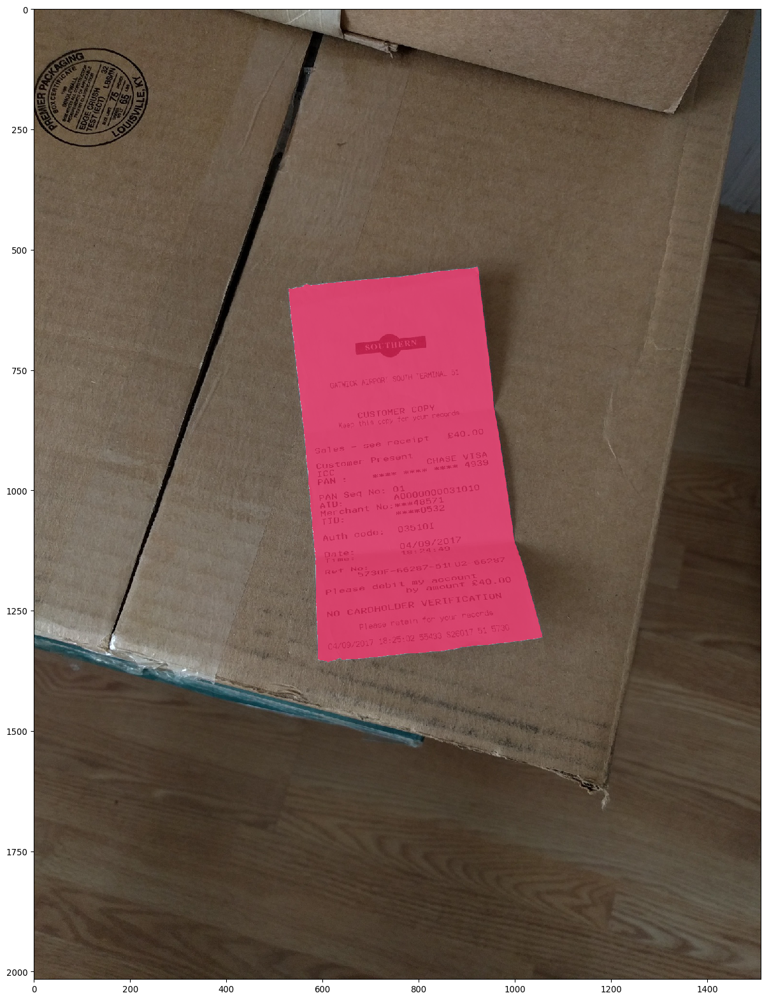

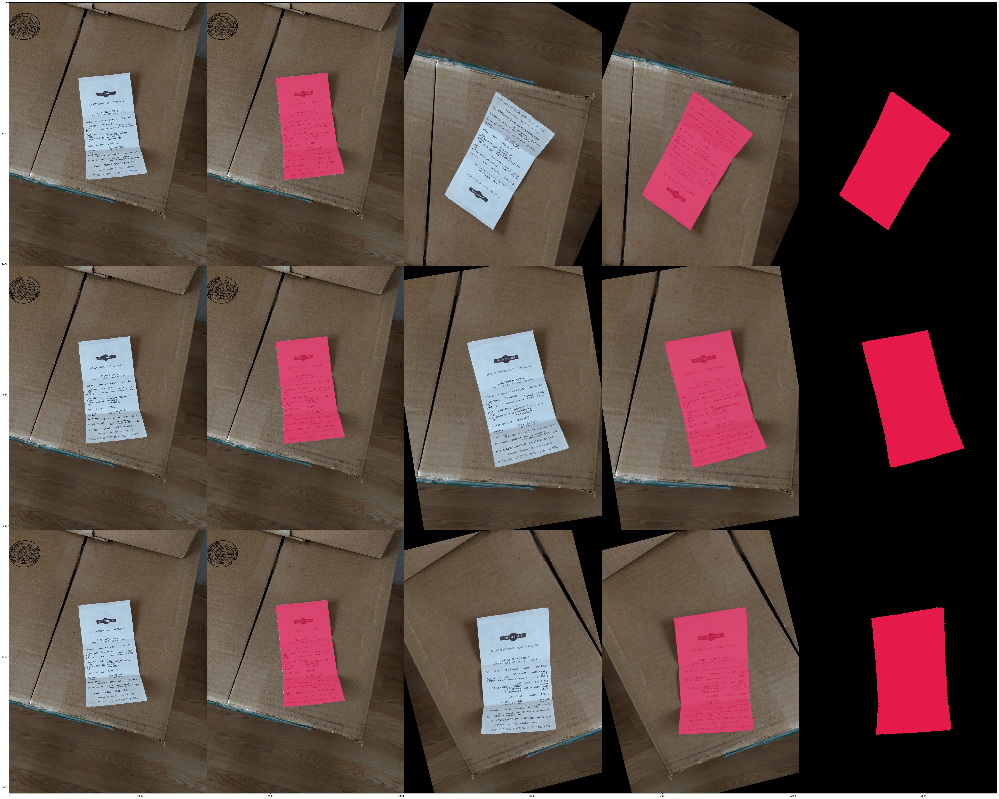

In [230]:
import cv2
from mrcnn import utils
import skimage
import imageio
import numpy as np
import imgaug as ia
import imgaug.augmenters as iaa
from imgaug.augmentables.segmaps import SegmentationMapOnImage
import matplotlib.pyplot as plt
file_path = './test'
image_list = os.listdir(file_path)
#mask_list = [image for image in image_list if image.split('.')[1] == 'png']
image_list = sorted([image for image in image_list if image.split('.')[1]!='png'])

image_list = image_list[1:]

    
for img in image_list:
    # Load image and mask
    print(img)
    mask_path = os.path.join('./test', img.split('.')[0] + '_color_mask.png')
    image = skimage.io.imread(os.path.join(file_path,img))
    h,w,_ = image.shape
    #print('image_id:',image_id)
    #print('image size',image.shape)
    segmap = skimage.io.imread(mask_path).astype('float32')
    segmap = SegmentationMapOnImage(segmap, nb_classes=3, shape=image.shape)
    ia.imshow(segmap.draw_on_image(image))
    
    
    # Define our augmentation pipeline.
    seq = iaa.Sequential([
        iaa.Fliplr(0.5),
        iaa.Flipud(0.5),
        #iaa.Dropout([0.05, 0.2]),      # drop 5% or 20% of all pixels
        #iaa.Sharpen((0.0, 1.0)),       # sharpen the image
        iaa.Affine(rotate=(-30, 30)),  # rotate by -30 to 30 degrees (affects segmaps)
        #iaa.ElasticTransformation(alpha=50, sigma=5)  # apply water effect (affects segmaps)
        iaa.PerspectiveTransform(scale=(0.01, 0.1))
    ], random_order=True)
    
    # Augment images and segmaps.
    images_aug = []
    segmaps_aug = []
    for k in range(3):
        images_aug_i, segmaps_aug_i = seq(image=image, segmentation_maps=segmap)
        mask = SegmentationMapOnImage.get_arr_int(segmaps_aug_i)
        mask = mask.astype(np.bool)
        #plt.imshow(mask)
        #plt.show()
        mask = mask.reshape([h, w, 1])
        
        # mask가 이미지 크기 밖으로 넘어가지 않을 경우에만 출력
        if mask[0].any() or mask[-1].any():
            pass
        else:
            mask = np.transpose(mask, axes=(1,0,2))
            if mask[0].any() or mask[-1].any():
                pass
            else:
                mask = np.transpose(mask, axes=(1,0,2))
                #cv2.imwrite(os.path.join('./train_aug','aug'+str(k)+'_'+img), images_aug_i)
                #cv2.imwrite(os.path.join('./mask_aug','aug'+str(k)+'_'+img.split('.')[0] + '_color_mask.png'), 
                #            segmaps_aug_i.draw(size=(h,w)))
                
                images_aug.append(images_aug_i)
                segmaps_aug.append(segmaps_aug_i)
        
        
    
    # We want to generate an image of original input images and segmaps
    # before/after augmentation.
    # It is supposed to have five columns: (1) original image, (2) original
    # image with segmap, (3) augmented image, (4) augmented
    # segmap on augmented image, (5) augmented segmap on its own in.
    # We now generate the cells of these columns.
    if images_aug:
        cells = []
        for image_aug, segmap_aug in zip(images_aug, segmaps_aug):
            cells.append(image)                                      # column 1
            cells.append(segmap.draw_on_image(image))                # column 2
            cells.append(image_aug)                                  # column 3
            cells.append(segmap_aug.draw_on_image(image_aug))        # column 4
            cells.append(segmap_aug.draw(size=image_aug.shape[:2]))  # column 5

        # Convert cells to grid image and save.
        grid_image = ia.draw_grid(cells, cols=5)
        ia.imshow(grid_image)
        #imageio.imwrite(os.path.join('./test','aug'+img), grid_image)